In [1]:
import pandas as pd
import os
import numpy as np
import glob
from scipy.stats import zscore
import matplotlib.pyplot as plt
from visualize_training.hmm import HMM
from visualize_training.visualize import visualize_dag, visualize_avg_log_likelihood, visualize_hmm_loss
from visualize_training.utils import training_run_json_to_csv, save_model, munge_data, load_model
pd.set_option('display.max_rows', 500)

In [2]:
def pizza_clock_classification(grad_sym_list, dist_irr_list, grad_sym_thresh=0.8, dist_irr_thresh=0.6):
    
    final_output = np.where(grad_sym_list>=grad_sym_thresh,"pizza",
                            np.where(dist_irr_list >=dist_irr_thresh,"clock",
                                     "pizza"))
    
    return final_output

In [3]:
parent_dir = "all_metrics"

for data_dir in glob.glob(parent_dir + '/'+  "*modular_clock_pizza*"):
    
    for filename in glob.glob(data_dir + "/*.csv"):
        attn = filename.split("/")[1].split("_")[-1]
        
        df = pd.read_csv(filename)
        df['attn'] = attn
        new_filename = filename.split("/")[2].split(".csv")[0] + f"_attn{attn}" + ".csv"
        df.to_csv(parent_dir + "/combined_attention/" + new_filename, index = False)

## Combined Attention with all metrics

In [39]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

first_n = 400
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
data_dir = parent_dir + f"/combined_attention/"
hmm_output = hmm_model.get_avg_log_likelihood(data_dir, cols)

visualize_avg_log_likelihood(hmm_output,"all metrics - modular_clock_pizza_run_combined_attention")

model_path = data_dir + '/model_all_metrics'
save_model(model_path,hmm_output)

all_metrics/combined_attention/
['all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed3_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed3_scaling1.0_attn0.2.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.6.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_sca

100%|██████████| 8/8 [00:25<00:00,  3.19s/it]


In [5]:
hmm_model.best_model 

GaussianHMM(n_components=8)

In [38]:
hmm_output['best_models']

[GaussianHMM(),
 GaussianHMM(n_components=2),
 GaussianHMM(n_components=3),
 GaussianHMM(n_components=4),
 GaussianHMM(n_components=5),
 GaussianHMM(n_components=6),
 GaussianHMM(n_components=6),
 GaussianHMM(n_components=8)]

In [22]:
-13338.841762932625 + 17981.660003808465

4642.81824087584

[6]


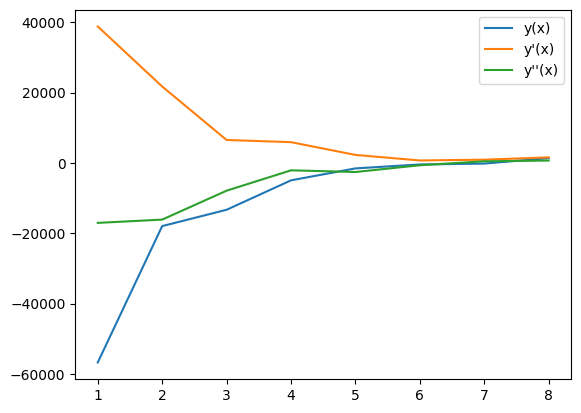

In [8]:
da = np.gradient(hmm_output['mean_scores'],1)
dda = np.gradient(da,1)
x = np.arange(1, max_components + 1)
x_zero_index = np.where(np.diff(np.sign(dda)))[0]
print(x[x_zero_index])

plt.plot(x, hmm_output['mean_scores'], label="y(x)")
plt.plot(x, da, label="y'(x)")
plt.plot(x, dda, label="y''(x)")
plt.legend()
plt.show()

In [69]:
dda

array([-17060.59714649, -16152.09039278,  -7874.43300775,  -2275.73236211,
        -2371.09720844,   -352.23026165,   -522.38565159,  -1036.32284899])

## All metrics, more components

### All metrics, attention = 0

In [43]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0/
['all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
1289.4878825717062


In [182]:
state_transitions['6>>3']

{'cols': ['train_accuracy', 'train_loss', 'eval_accuracy'],
 'feature_changes': [1.1295610404026086,
  -1.318841443266403,
  3.294771799546726,
  -3.2363426944624356,
  -3.0522337487633253,
  -1.1908853606921042,
  -2.79667156007046,
  -2.8860537016148147,
  -2.930772989887385,
  1.1108109113003173,
  -1.6251619371532722,
  2.1115022197586533,
  2.0968289786135386,
  -0.31032009298636276,
  -0.6313090447273189,
  -0.07476257289766214,
  -0.15135047040304114,
  1.771029376959099,
  -0.26449094723845884,
  -1.8817024175621169]}

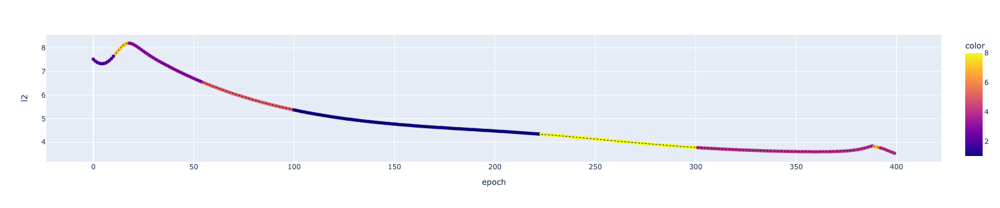

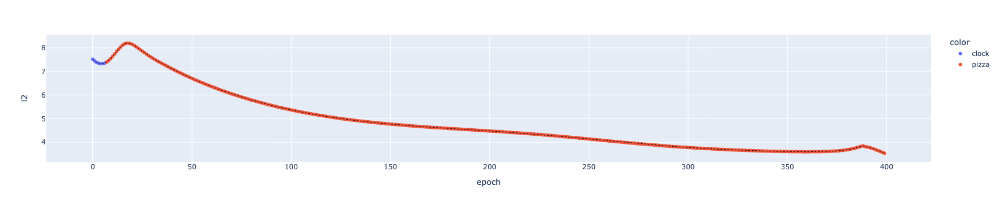

In [212]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_model'].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

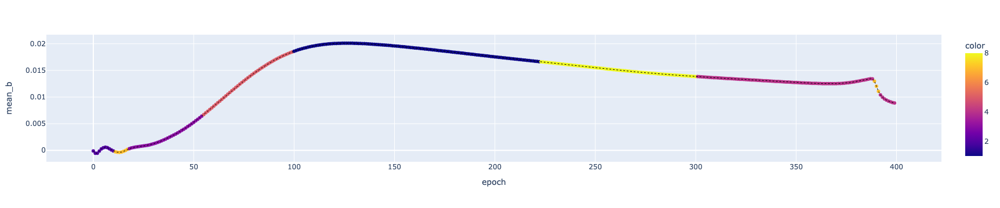

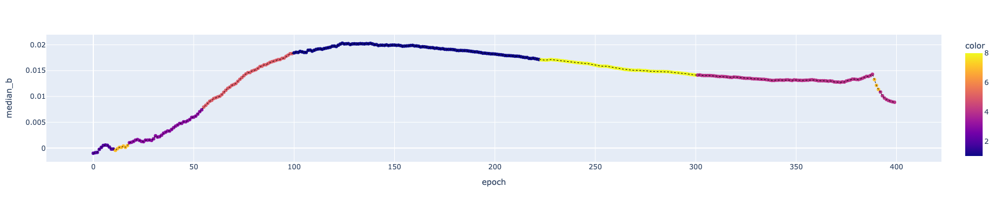

In [213]:
## for random seed = 1 and 2, transition is 7>>3, due to median b
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='mean_b')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='median_b')

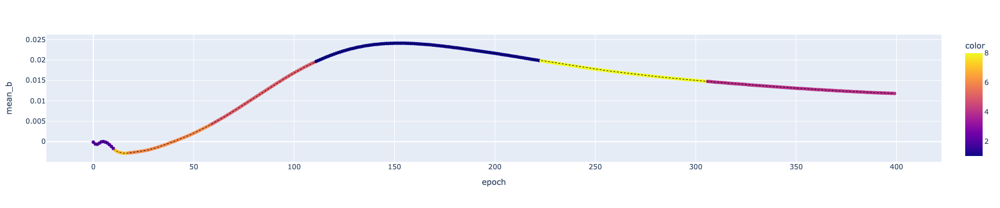

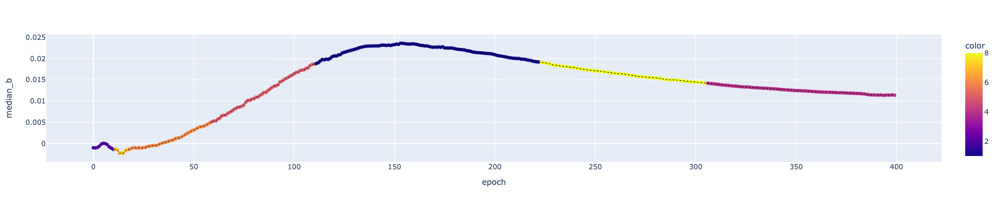

In [205]:
## for random seed = 0 and 3, transition is 7>>6, due to mean b
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='mean_b')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='median_b')

#### reason for 4>>7, and 7>>4 transition is due to spikes in eval loss and train loss

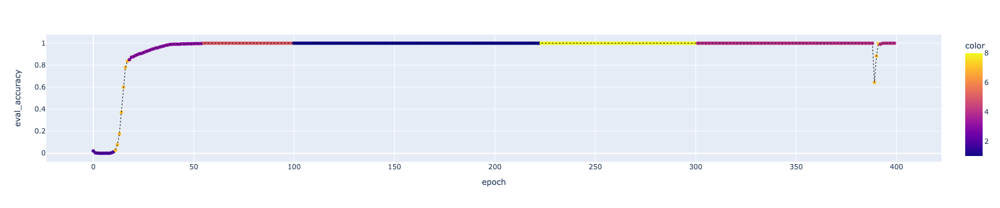

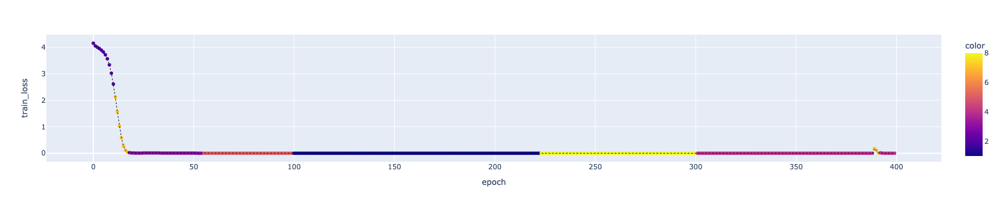

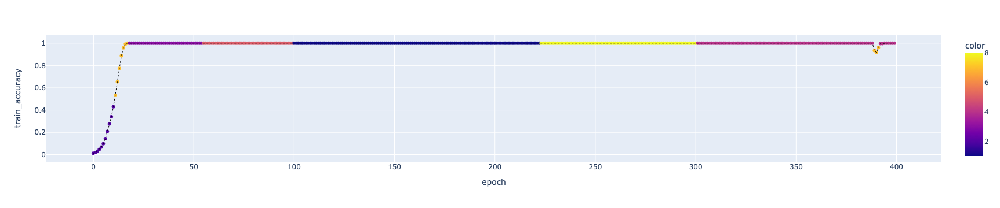

In [184]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy')

### All metrics, attention = 0.2

In [185]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.2
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.2/
['all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
2296.4214193435164


In [190]:
state_transitions['6>>3']

{'cols': ['train_accuracy', 'train_loss', 'eval_accuracy'],
 'feature_changes': [1.1295610404026086,
  -1.318841443266403,
  3.294771799546726,
  -3.2363426944624356,
  -3.0522337487633253,
  -2.79667156007046,
  -2.8860537016148147,
  -1.1908853606921042,
  -2.930772989887385,
  -1.6251619371532722,
  1.771029376959099,
  -1.8817024175621169,
  1.1108109113003173,
  2.0968289786135386,
  -0.26449094723845884,
  -0.6313090447273189,
  -0.07476257289766214,
  -0.15135047040304114,
  2.1115022197586533,
  -0.31032009298636276]}

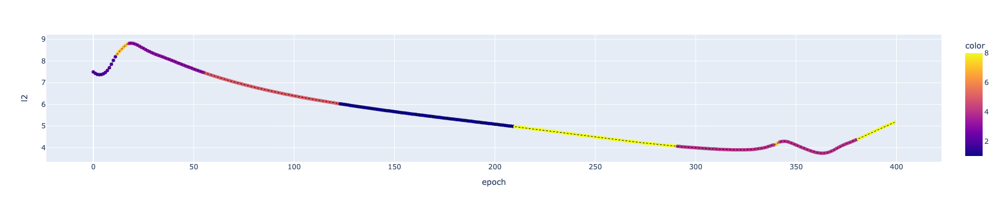

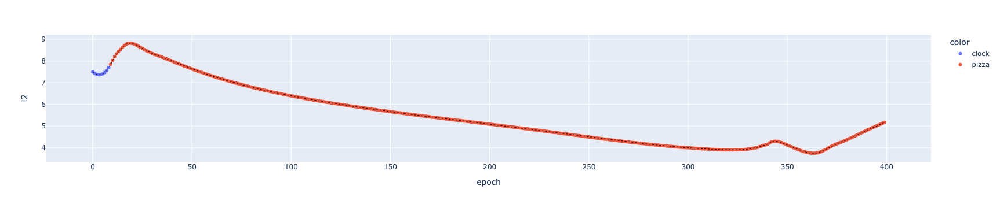

In [191]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

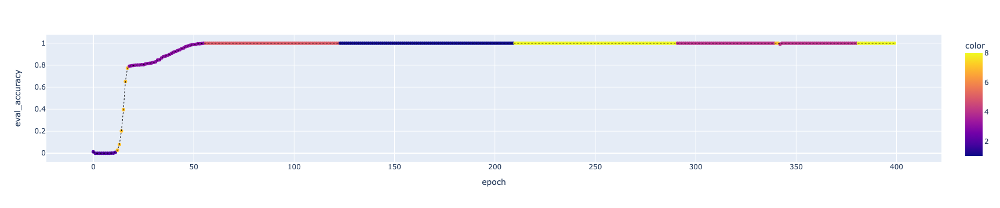

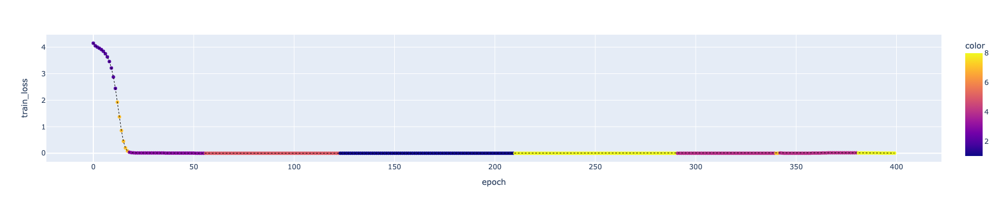

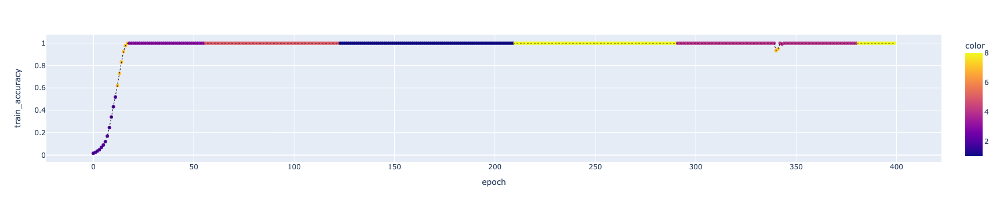

In [192]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy')

### All metrics, attention = 0.4

In [193]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.4
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.4/
['all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
5932.936384886915


In [194]:
state_transitions['6>>3']

{'cols': ['train_accuracy', 'train_loss', 'eval_loss'],
 'feature_changes': [1.1295610404026086,
  -1.318841443266403,
  -3.2363426944624356,
  -3.0522337487633253,
  3.294771799546726,
  -1.1908853606921042,
  -2.79667156007046,
  -0.26449094723845884,
  1.771029376959099,
  -2.8860537016148147,
  -0.07476257289766214,
  -1.6251619371532722,
  -2.930772989887385,
  -0.15135047040304114,
  1.1108109113003173,
  2.1115022197586533,
  -1.8817024175621169,
  -0.6313090447273189,
  2.0968289786135386,
  -0.31032009298636276]}

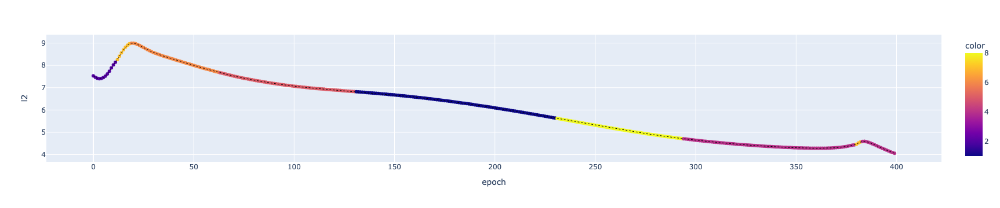

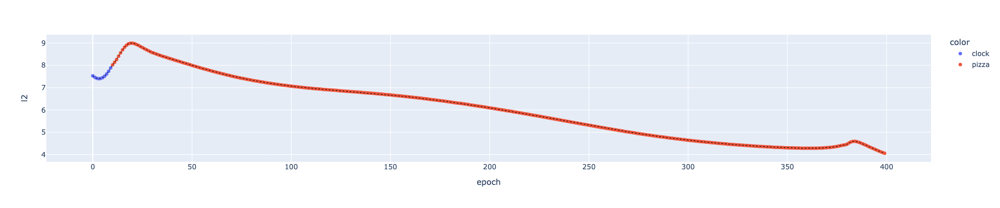

In [200]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

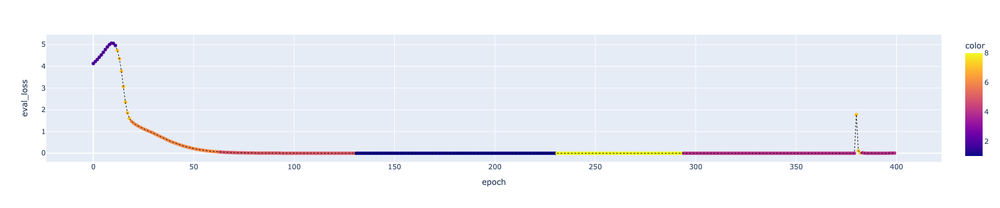

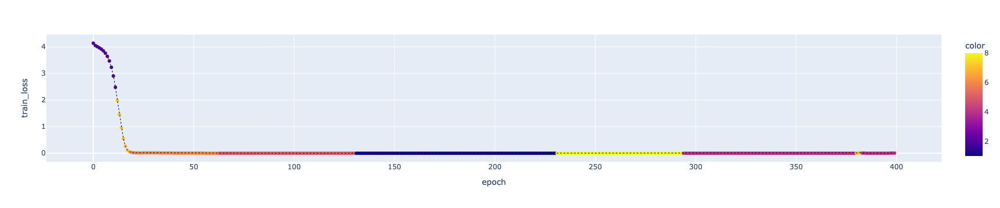

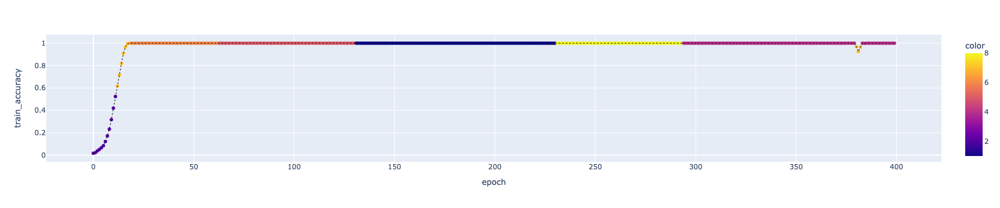

In [201]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_loss')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy')

### All metrics, attention = 0.6

In [202]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.6
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.6/
['all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
4566.629165961677


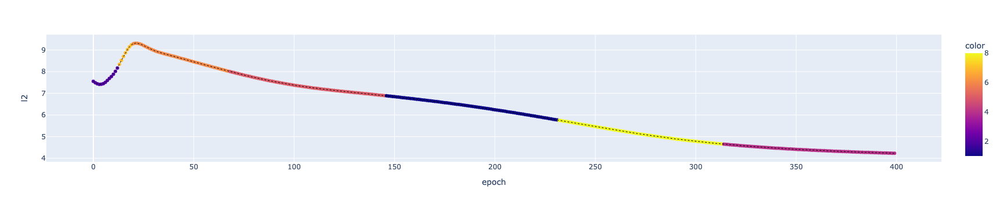

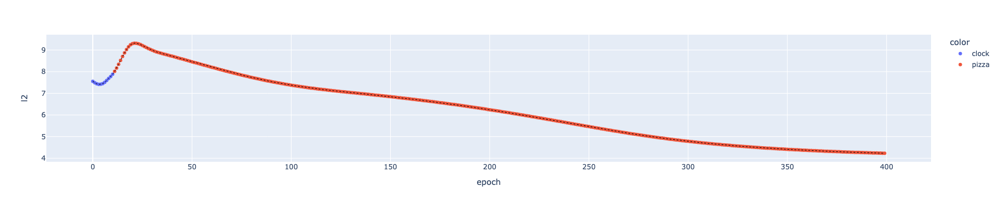

In [13]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

In [ ]:
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='grad_sym')

### All metrics, attention = 0.8

In [214]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.8
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.8/
['all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
3953.636998770906


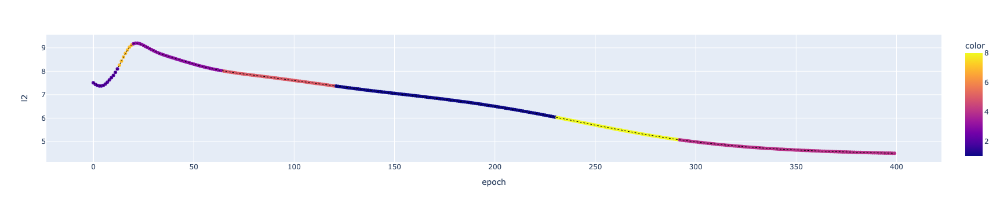

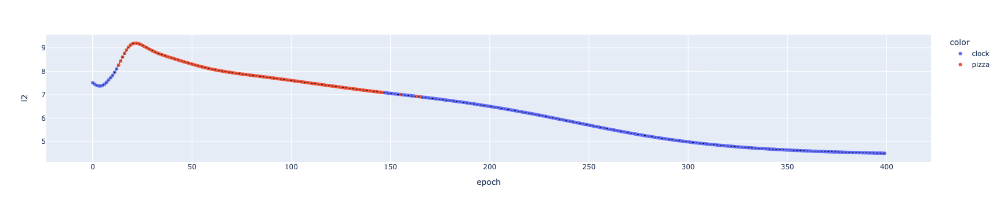

In [215]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

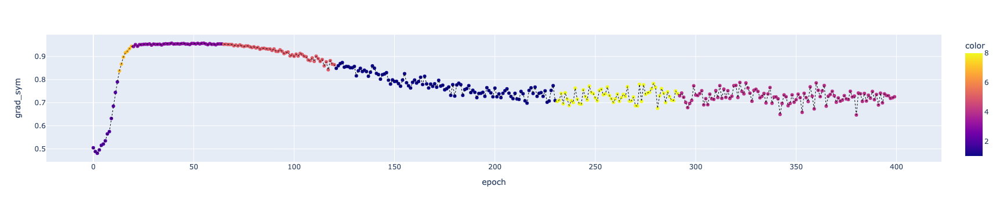

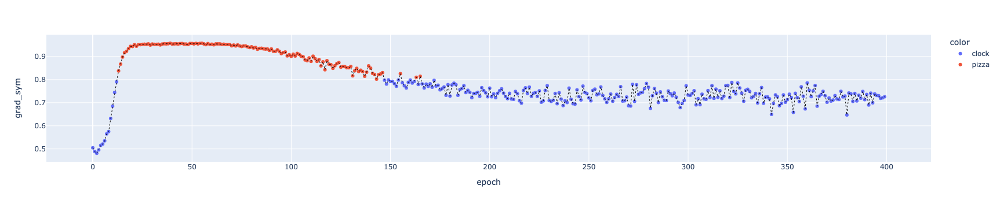

In [216]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='grad_sym')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='grad_sym')

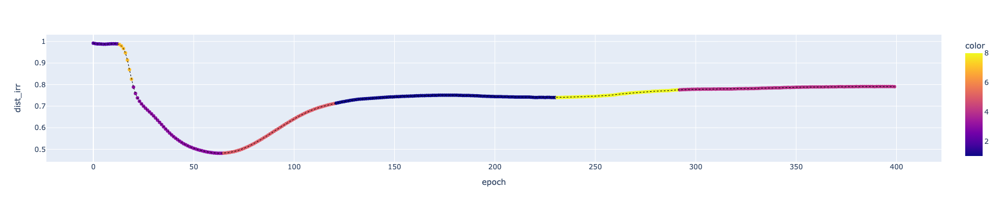

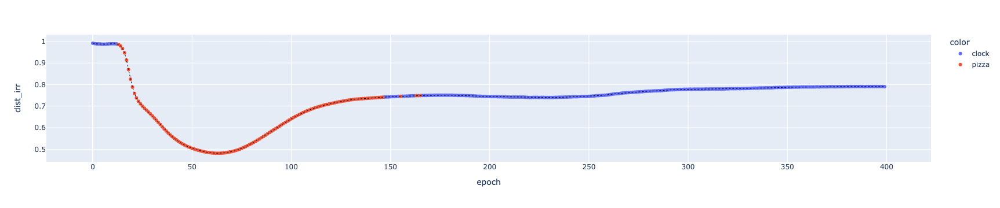

In [217]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='dist_irr')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='dist_irr')

### All metrics, attention = 1

In [107]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 1
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_1/
['all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
1390.5159526967072


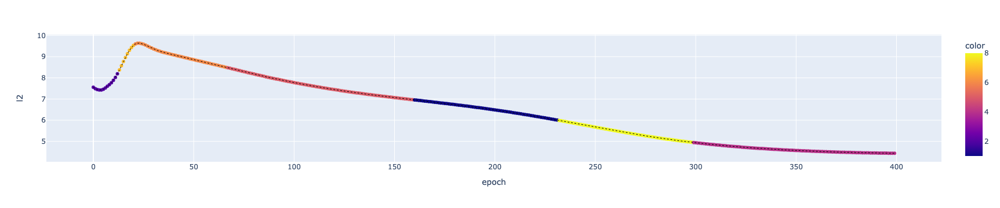

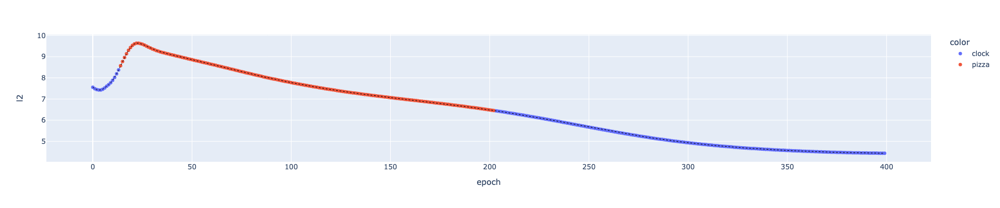

In [17]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

## All metrics, less components

### All metrics, attention = 0, less components

In [50]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0/
['all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
-4829.152482011397


In [53]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

In [56]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy')

### All metrics, attention = 0.2, less components

In [58]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.2
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.2/
['all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
-4478.869047597915


In [64]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

In [66]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')

### All metrics, attention = 0.4, less components

In [67]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.4
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.4/
['all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
-1384.355555052929


In [68]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### All metrics, attention = 0.6, less components

In [69]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.6
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.6/
['all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
-2067.734452559382


In [70]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### All metrics, attention = 0.8, less components

In [71]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.8
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.8/
['all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
-2896.6393362086546


In [72]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### All metrics, attention = 1, less components

In [73]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b','grad_sym',
       'dist_irr', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 1
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_all_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_all_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_1/
['all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
-6352.702460632403


In [74]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

## Combined Attention with old metrics

In [75]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

first_n = 400
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
data_dir = parent_dir + f"/combined_attention/"
hmm_output = hmm_model.get_avg_log_likelihood(data_dir, cols)

visualize_avg_log_likelihood(hmm_output,"old metrics - modular_clock_pizza_run_combined_attention")

model_path = data_dir + '/model_old_metrics'
save_model(model_path,hmm_output)

all_metrics/combined_attention/
['all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed3_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed3_scaling1.0_attn0.2.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.6.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_sca

 12%|█▎        | 1/8 [00:00<00:02,  2.52it/s]Model is not converging.  Current: -56578.056793782285 is not greater than -56577.71471049308. Delta is -0.34208328920794884
Model is not converging.  Current: -56578.47394996191 is not greater than -56578.032737451795. Delta is -0.4412125101152924
Model is not converging.  Current: -56578.39031726587 is not greater than -56577.95187582929. Delta is -0.43844143657770474
Model is not converging.  Current: -56577.952245463806 is not greater than -56577.71620912136. Delta is -0.23603634244500427
100%|██████████| 8/8 [00:22<00:00,  2.80s/it]


[6]


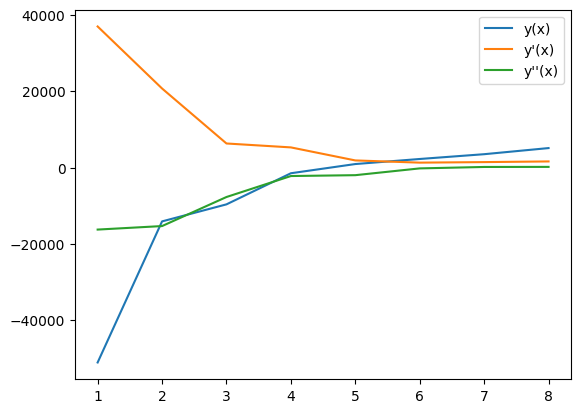

In [13]:
da = np.gradient(hmm_output['mean_scores'],1)
dda = np.gradient(da,1)
x = np.arange(1, max_components + 1)
x_zero_index = np.where(np.diff(np.sign(dda)))[0]
print(x[x_zero_index])

plt.plot(x, hmm_output['mean_scores'], label="y(x)")
plt.plot(x, da, label="y'(x)")
plt.plot(x, dda, label="y''(x)")
plt.legend()
plt.show()

## Old metrics, more components

### Old metrics, attention = 0

In [20]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0/
['all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
2842.139818417342


In [153]:
best_model_transmat[0][7]

4.2415555402483134e-67

In [151]:
state_transitions['0>>7']

{'cols': ['mean_lambda', 'l2', 'l1'],
 'feature_changes': [2.8551921025046316,
  2.597495093840222,
  2.3111616777962958,
  2.604696975525248,
  4.3495784667760775,
  3.125811894640136,
  0.23591061046355538,
  0.4432851053198362,
  -0.5060591100516254,
  0.07532870686740972,
  0.07493277985805213,
  -2.9480608049885824,
  -0.5602247174403998,
  -2.540520061291972,
  -4.393156817415125,
  -2.1723591967324336,
  -2.5927419949372057,
  -2.5345514233342294]}

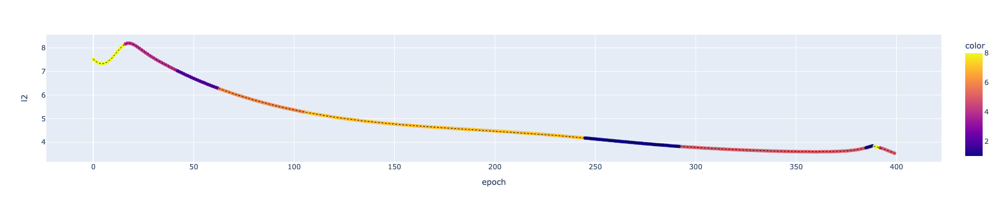

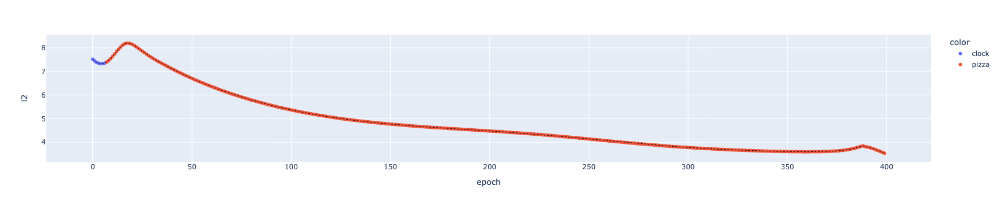

In [154]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

#### 5>>1, 1>>8 (trans prob is very low, hence no connection show in dag), 8>>4, 4>>5 detour happening due to sudden drop in eval accuracy

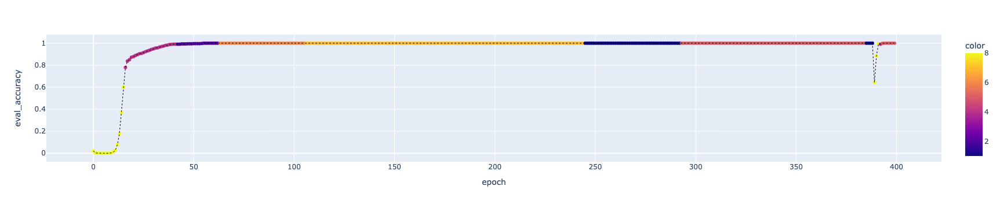

In [155]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy')

### Old Metrics, attention = 0.2

In [156]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.2
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.2/
['all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
3270.667254680865


In [166]:
state_transitions['0>>6']

{'cols': ['train_accuracy', 'var_w', 'l1'],
 'feature_changes': [-0.0009975579523929523,
  0.7446217583799714,
  0.9724365955683008,
  0.6815418257069316,
  0.4555800623304234,
  -0.013614389693194173,
  0.9007773095584195,
  0.9355933788546992,
  1.0588027029863476,
  0.4476980793000453,
  1.465091051320199,
  0.4328662374045744,
  1.1414862807272086,
  -0.15692708718521556,
  0.2762534425308336,
  0.37989781887032,
  0.014312666141186425,
  0.0013171629625785553]}

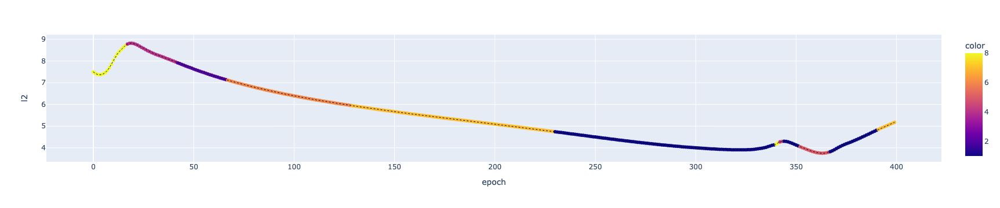

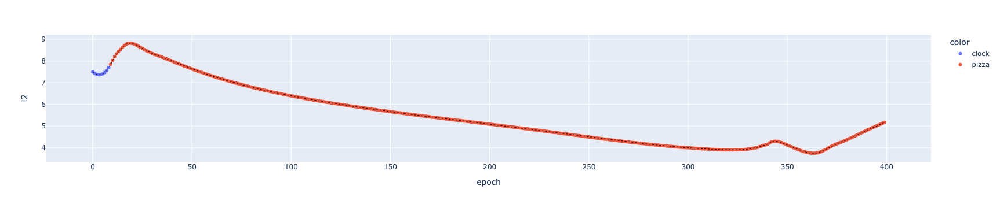

In [157]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

In [ ]:
### detour 

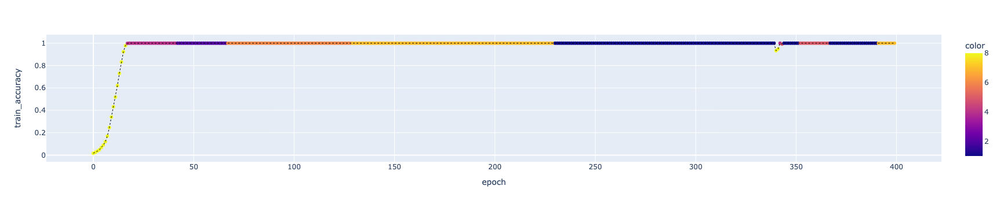

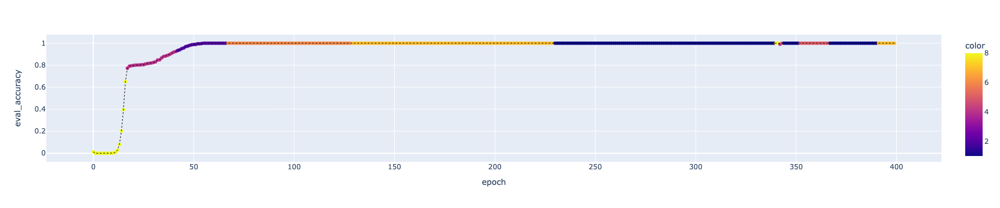

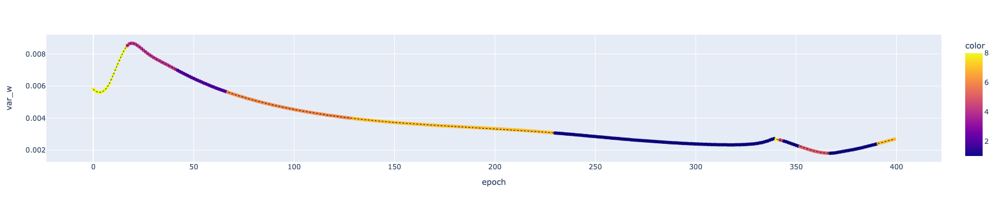

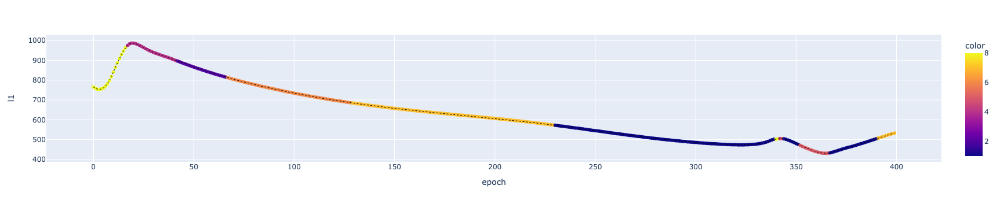

In [167]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_accuracy')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_w')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l1')

### Old metrics, attention = 0.4

In [168]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.4
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.4/
['all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
7027.7497088849905


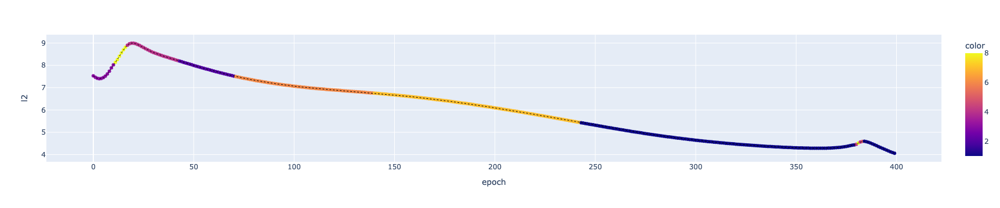

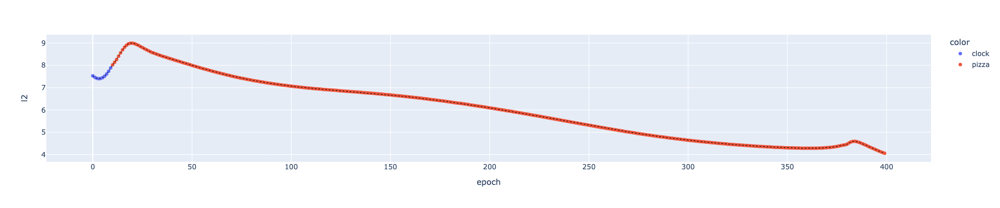

In [172]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

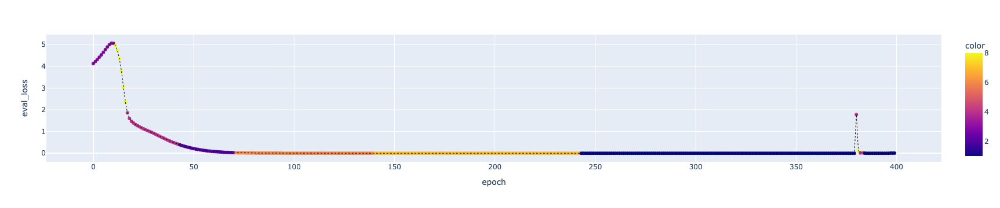

In [173]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')

### Old metrics, attention = 0.6

In [174]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.6
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.6/
['all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
6270.196273381723


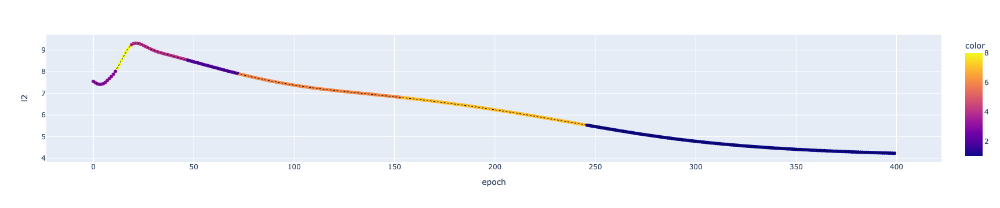

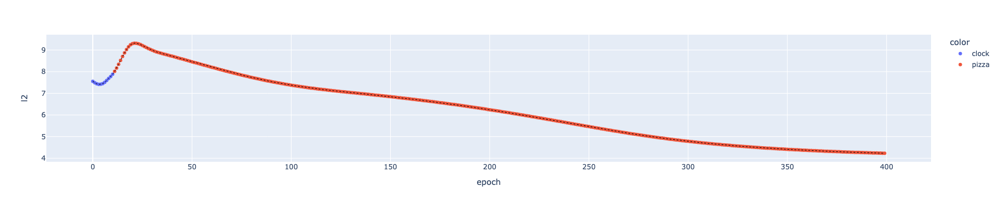

In [175]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

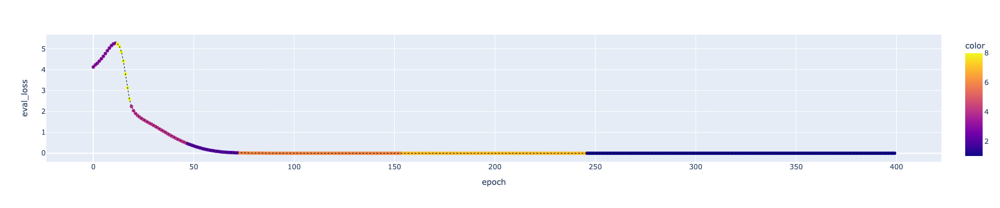

In [176]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')

### Old metrics, attention = 0.8

In [112]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 0.8
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.8/
['all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
6628.01824499787


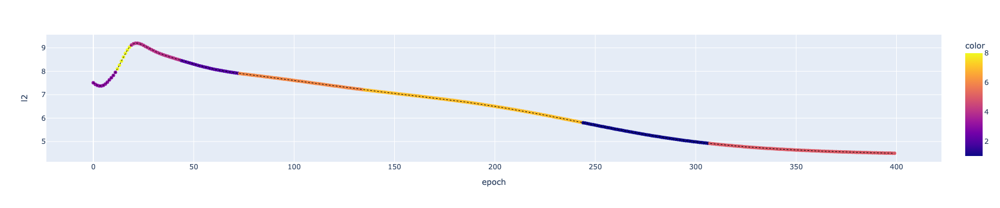

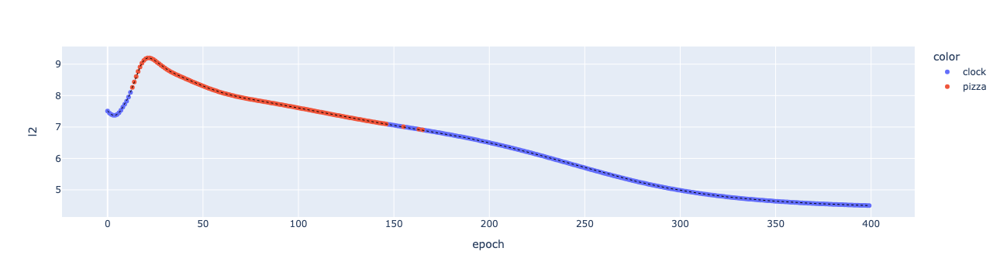

In [27]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Old metrics, attention = 1

In [113]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 8
attn = 1
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_1/
['all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
4453.210818289302


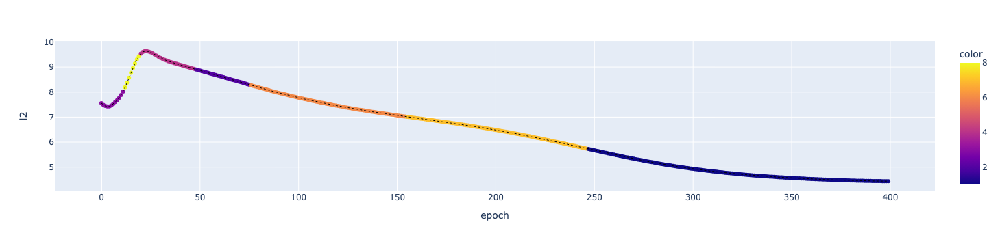

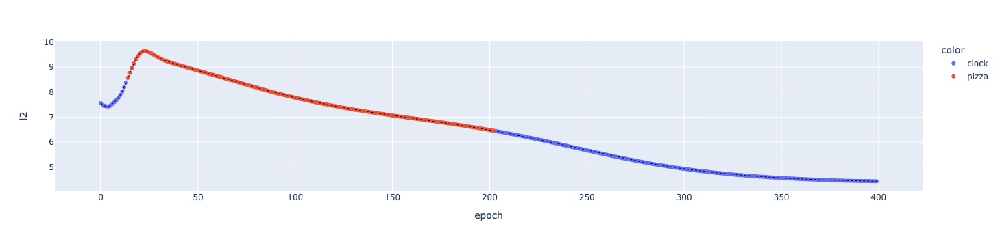

In [62]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_model.best_model.predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

## Old metrics, less components

### Old metrics, less components, attention = 0

In [92]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=4)
all_metrics/modular_clock_pizza_run_0/
['all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
-2714.897844331279


In [93]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

In [95]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='train_accuracy')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='var_w')

### Old metrics, less components, attention = 0.2

In [81]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.2
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=4)
all_metrics/modular_clock_pizza_run_0.2/
['all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
-1918.0875851048265


In [82]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Old metrics, less components, attention = 0.4

In [83]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.4
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=4)
all_metrics/modular_clock_pizza_run_0.4/
['all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
738.643720458757


In [84]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Old metrics, less components, attention = 0.6

In [85]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.6
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=4)
all_metrics/modular_clock_pizza_run_0.6/
['all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
77.4741312085282


In [86]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Old metrics, less components, attention = 0.8

In [87]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 0.8
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=4)
all_metrics/modular_clock_pizza_run_0.8/
['all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
747.8692882004325


In [96]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Old metrics, less components, attention = 1

In [98]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = ['l1', 'l2', 'trace', 'spectral', 'code_sparsity',
       'computational_sparsity', 'mean_lambda', 'variance_lambda', 'mean_w',
       'median_w', 'var_w', 'mean_b', 'median_b', 'var_b', 'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 4
attn = 1
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_old_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
print("chosen_model: ", hmm_output['best_models'][n_components - 1])
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_output['best_models'][n_components - 1].predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_old_metrics.pkl
best_model:  GaussianHMM(n_components=8)
chosen_model:  GaussianHMM(n_components=4)
all_metrics/modular_clock_pizza_run_1/
['all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
-1779.2570403217264


In [99]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

## Combined attention with select metrics

In [101]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
        
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

first_n = 400
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
data_dir = parent_dir + f"/combined_attention/"
hmm_output = hmm_model.get_avg_log_likelihood(data_dir, cols)

visualize_avg_log_likelihood(hmm_output,"select metrics - modular_clock_pizza_run_combined_attention")

model_path = data_dir + '/model_select_metrics'
save_model(model_path,hmm_output)

all_metrics/combined_attention/
['all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed3_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.8.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed1_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed3_scaling1.0_attn0.2.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn0.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_scaling1.0_attn0.6.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed2_scaling1.0_attn1.csv', 'all_metrics/combined_attention/lr0.001_adamw_seed0_sca

100%|██████████| 8/8 [00:16<00:00,  2.10s/it]


In [66]:
dda

array([-14433.82967975, -14743.04860762,  -7994.79955063,   -682.38120517,
         -152.67459219,     44.86456682,   -147.66192391,   -262.97132128])

[5 6]


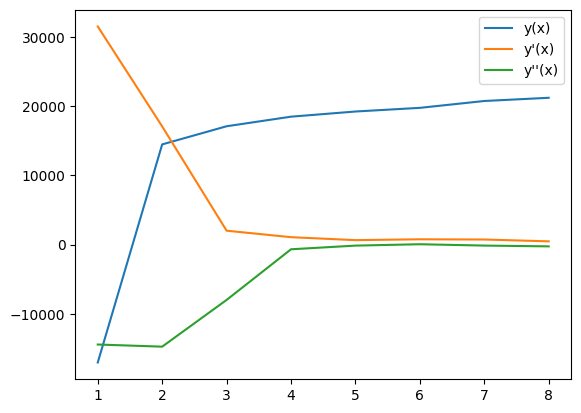

In [65]:
da = np.gradient(hmm_output['mean_scores'],1)
dda = np.gradient(da,1)
x = np.arange(1, max_components + 1)
x_zero_index = np.where(np.diff(np.sign(dda)))[0]
print(x[x_zero_index])

plt.plot(x, hmm_output['mean_scores'], label="y(x)")
plt.plot(x, da, label="y'(x)")
plt.plot(x, dda, label="y''(x)")
plt.legend()
plt.show()

## Select metrics, more components

### Select metrics, attention = 0

In [7]:
hmm_output['best_models'][4]

GaussianHMM(n_components=5)

In [50]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 7
attn = 0
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0/
['all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
16665.216111770143


In [124]:
state_transitions['5>>0']

{'cols': ['train_loss', 'train_accuracy', 'eval_accuracy'],
 'feature_changes': [-3.608708722679586,
  3.2557503306138016,
  4.979826423732092,
  -5.162818827416742,
  -2.0723569413146037,
  -2.5068587369348148]}

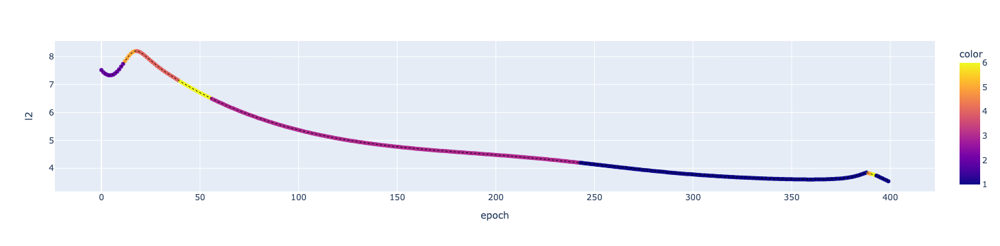

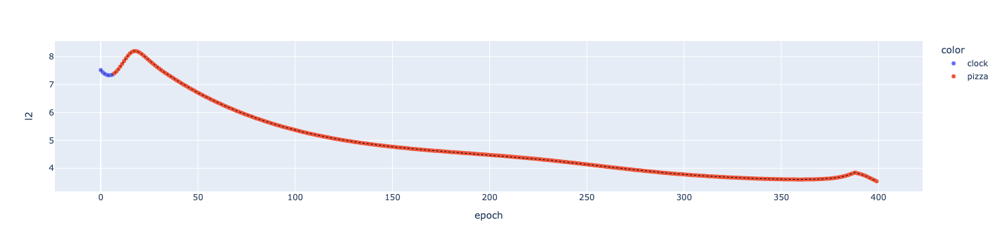

In [118]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### sudden increase in eval_loss is leading to the detour 1>>5, 5>>6, 6>>1

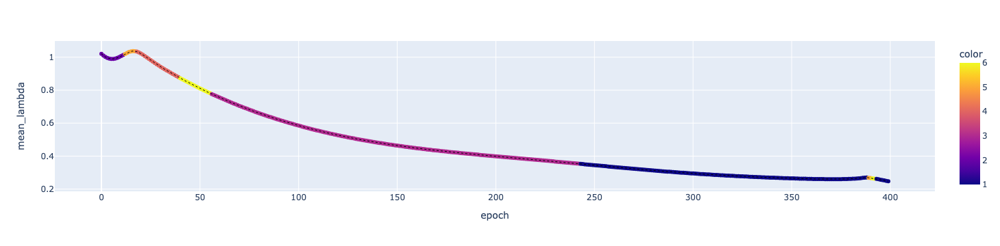

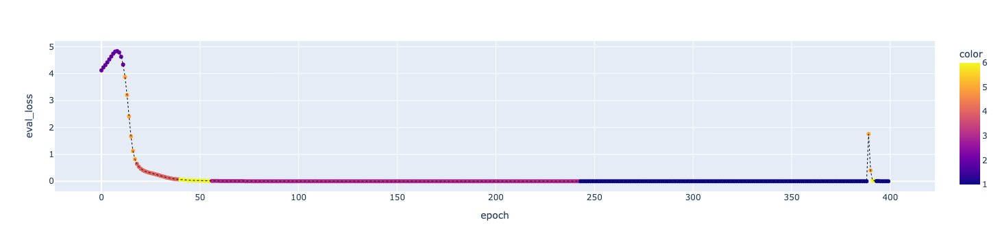

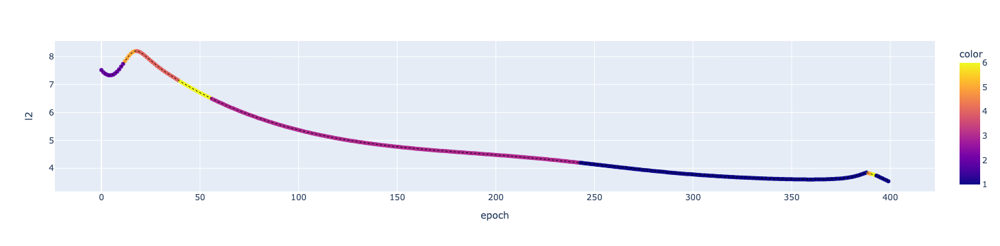

In [119]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='mean_lambda')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')

### Select metrics, attention = 0.2

In [126]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 7
attn = 0.2
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.2/
['all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
16955.09999112349


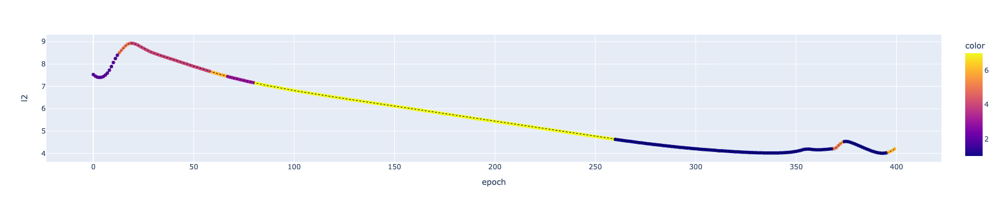

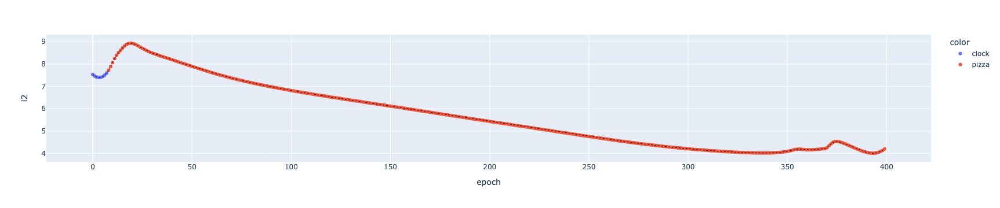

In [130]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

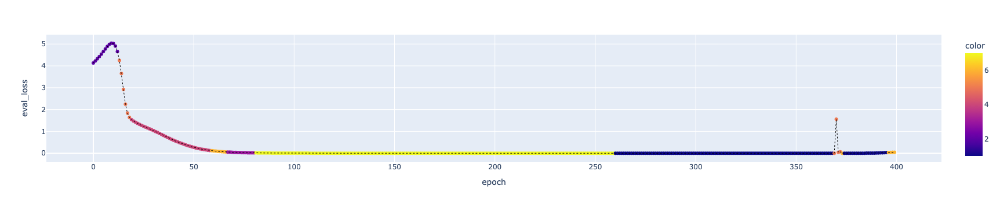

In [131]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')

### Select metrics, attention = 0.4

In [132]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 7
attn = 0.4
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.4/
['all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
18075.618787357944


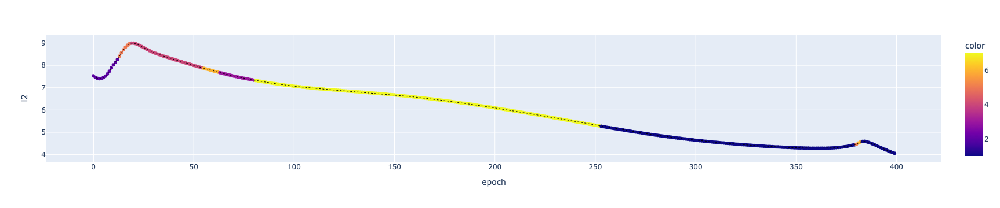

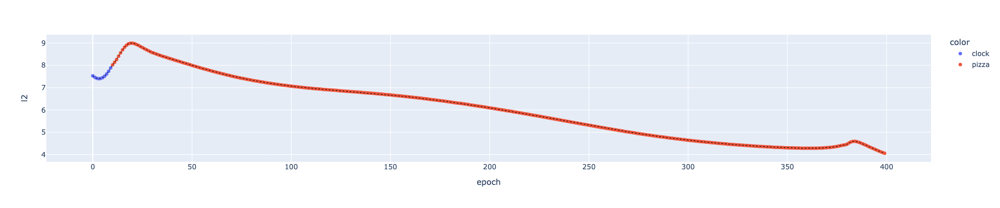

In [133]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

#### reason for 1>>5 detour

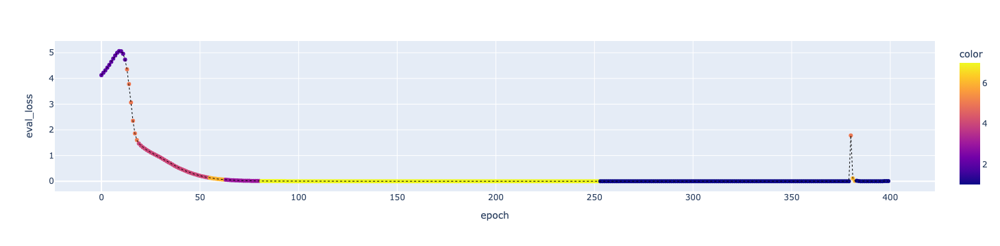

In [134]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')

### Select metrics, attention = 0.6

In [135]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 7
attn = 0.6
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.6/
['all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
17789.256748889453


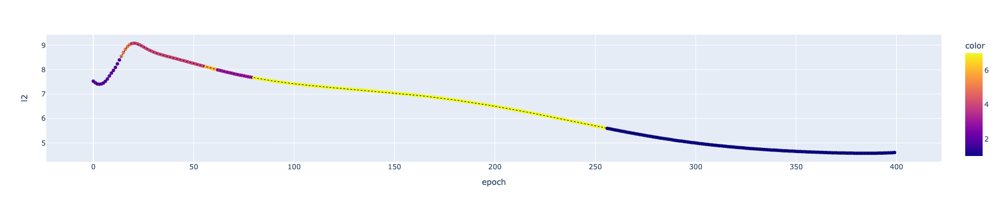

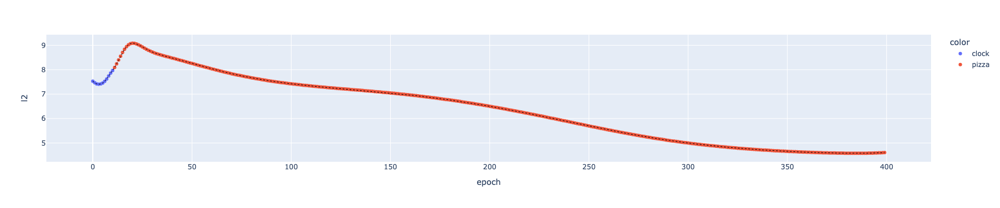

In [139]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

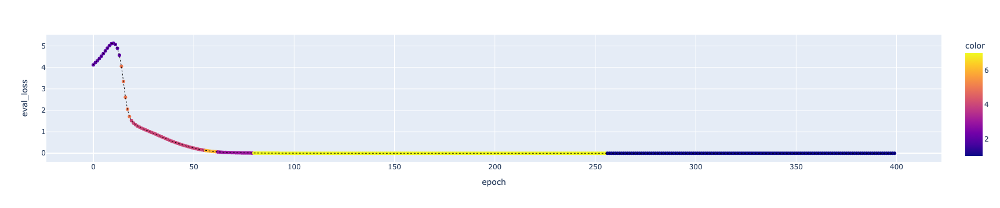

In [140]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='eval_loss')

### Select metrics, attention = 0.8

In [141]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 7
attn = 0.8
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_0.8/
['all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
17267.352398338957


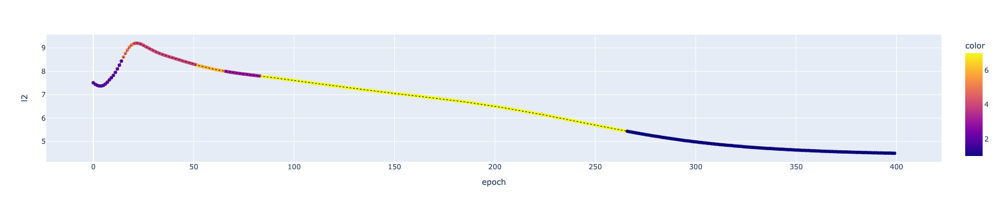

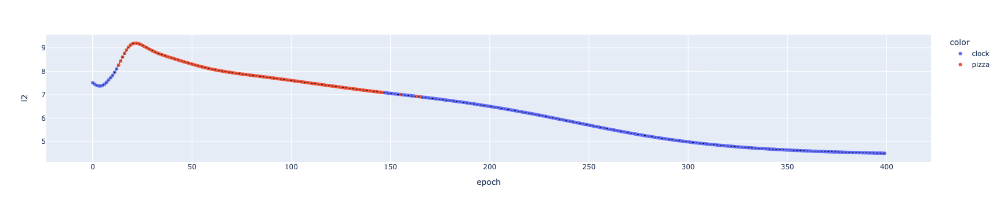

In [74]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Select metrics, attention = 1

In [13]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 7
attn = 1
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=8)
all_metrics/modular_clock_pizza_run_1/
['all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
14468.464795709882


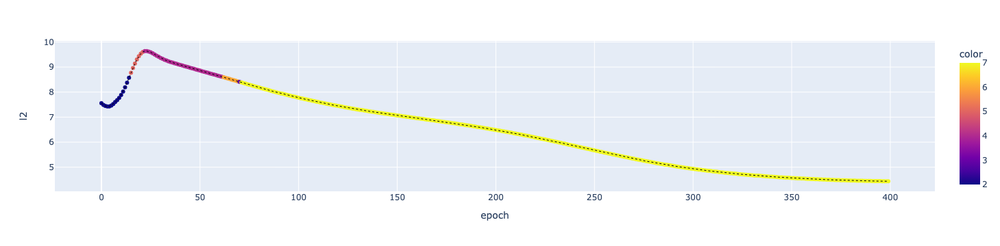

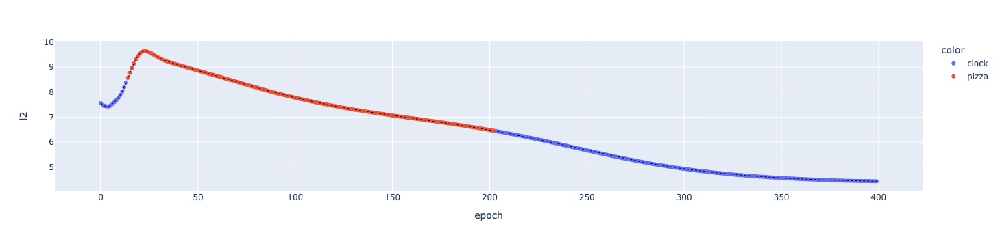

In [83]:
random_seed = 0
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

## Select metrics, less components

### Select metrics, less components, attention = 0

In [105]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 3
attn = 0
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=7)
all_metrics/modular_clock_pizza_run_0/
['all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0/lr0.001_adamw_seed0_scaling1.0.csv']
13131.62428565649


In [106]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Select metrics, less components, attention = 0.2

In [109]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 3
attn = 0.2
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=7)
all_metrics/modular_clock_pizza_run_0.2/
['all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.2/lr0.001_adamw_seed0_scaling1.0.csv']
12961.624047417215


In [110]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.2
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

In [111]:
visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col="mean_lambda")

### Select metrics, less components, attention = 0.4

In [112]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 3
attn = 0.4
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=7)
all_metrics/modular_clock_pizza_run_0.4/
['all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.4/lr0.001_adamw_seed0_scaling1.0.csv']
14120.5014941378


In [116]:
random_seed = 3
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.4
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Select metrics, less components, attention = 0.6

In [117]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 3
attn = 0.6
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=7)
all_metrics/modular_clock_pizza_run_0.6/
['all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.6/lr0.001_adamw_seed0_scaling1.0.csv']
13852.086934900453


In [118]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.6
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Select metrics, less components, attention = 0.8

In [119]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 3
attn = 0.8
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=7)
all_metrics/modular_clock_pizza_run_0.8/
['all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_0.8/lr0.001_adamw_seed0_scaling1.0.csv']
13968.258101250647


In [120]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 0.8
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')

### Select metrics, less components, attention = 1

In [121]:
max_components = 8
cov_type = "diag"
n_seeds = 4
n_iter = 10
cols = [ 'l2',  
      'mean_lambda', 
       'train_loss', 'eval_loss', 'train_accuracy',
       'eval_accuracy']

n_components = 3
attn = 1
data_dir = parent_dir + f"/combined_attention/"
model_path = data_dir + 'model_select_metrics.pkl'
hmm_output = load_model(model_path)
hmm_model = HMM(max_components, cov_type, n_seeds, n_iter)
hmm_model.best_model = hmm_output['best_model']
print("model_path: ", model_path)
print("best_model: ", hmm_model.best_model)
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"
model, data, best_predictions, lengths = munge_data(hmm_model, model_path, attn_data_dir, cols, n_components)

phases = list(set(hmm_model.best_model.predict(data, lengths=lengths)))
state_transitions = hmm_model.feature_importance(cols, data, best_predictions,phases,lengths)
best_model_transmat = model.transmat_

visualize_dag(best_model_transmat, edge_hover_dict = state_transitions)

model_path:  all_metrics/combined_attention/model_select_metrics.pkl
best_model:  GaussianHMM(n_components=7)
all_metrics/modular_clock_pizza_run_1/
['all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed2_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed3_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed1_scaling1.0.csv', 'all_metrics/modular_clock_pizza_run_1/lr0.001_adamw_seed0_scaling1.0.csv']
10801.22321904507


In [122]:
random_seed = 1
optimizer = "adamw"
lr = 0.001
scaling = 1.0
attn = 1
attn_data_dir = parent_dir + f"/modular_clock_pizza_run_{attn}/"


training_run = pd.read_csv(f'{attn_data_dir}lr{lr}_{optimizer}_seed{random_seed}_scaling{scaling}.csv')
data  = np.apply_along_axis(zscore, 0, training_run[cols].to_numpy())
training_run['phases']= hmm_output['best_models'][n_components - 1].predict(data) + 1
training_run['pizza_clock_labels'] = pizza_clock_classification(training_run['grad_sym'], training_run['dist_irr'])
# training_run['phases']= hmm_model.best_model.predict(data)

visualize_hmm_loss(training_run,phase_col = 'phases', epoch_col='epoch', loss_col='l2')
visualize_hmm_loss(training_run,phase_col = 'pizza_clock_labels', epoch_col='epoch', loss_col='l2')